In [2]:
!pip install diffusers
!pip install transformers scipy ftfy accelerate
!pip install compel
!pip install torchsde

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 270.9/270.9 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 3.3 MB/s eta 0:00:00


In [3]:
import PIL
from PIL import Image

# Code for visualization of multiple images
def image_grid(imgs, rows, cols):
    """
    This function takes a list of images and creates a grid of images from them.

    Args:
    imgs (list): List of images to be used in the grid.
    rows (int): Number of rows in the grid.

    Returns:
    grid (Image): The grid of images.
    """

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

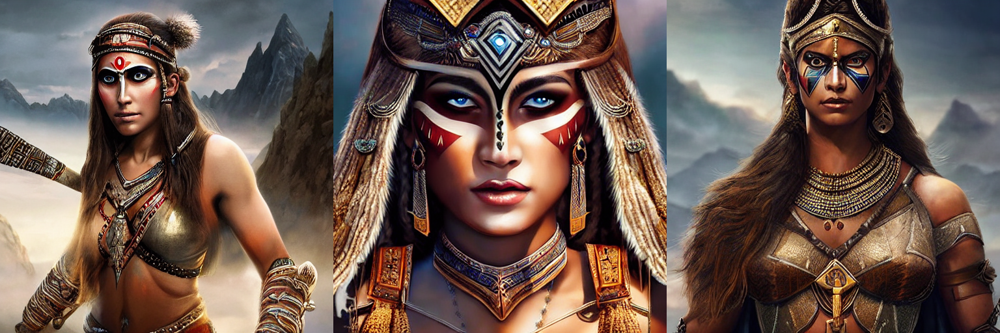

In [6]:
import torch
from diffusers import StableDiffusionPipeline

pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "digital painting portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

In [5]:
# If you want to access the schedular, parameters you can use this code.
# Default scheduler is PNDMScheduler.
pipeline.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.26.2",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": null
}

In [ ]:

# You can see the all available schedulers of Stable Diffusion
pipeline.scheduler.compatibles

[diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_dpmsolver_sde.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMSc

  0%|          | 0/50 [00:00<?, ?it/s]

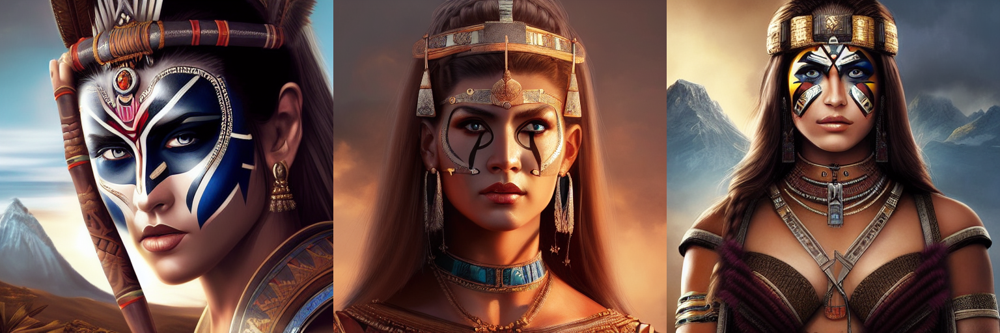

In [ ]:
# From now on we're going to try different schedulers and see the variations on images.

from diffusers import DDPMScheduler, KDPM2DiscreteScheduler, DPMSolverMultistepScheduler, HeunDiscreteScheduler, KDPM2AncestralDiscreteScheduler, EulerAncestralDiscreteScheduler, UniPCMultistepScheduler, DPMSolverSDEScheduler, EulerDiscreteScheduler, DPMSolverSinglestepScheduler, DEISMultistepScheduler, DDIMScheduler, LMSDiscreteScheduler

pipeline.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

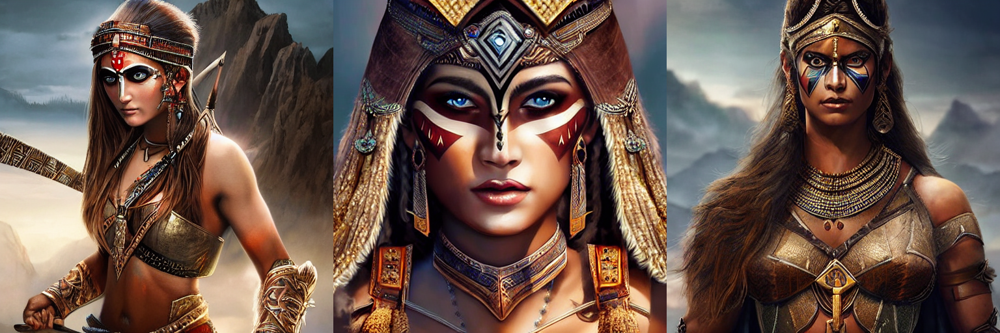

In [ ]:
# KDPM2DiscreteScheduler

pipeline.scheduler = KDPM2DiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

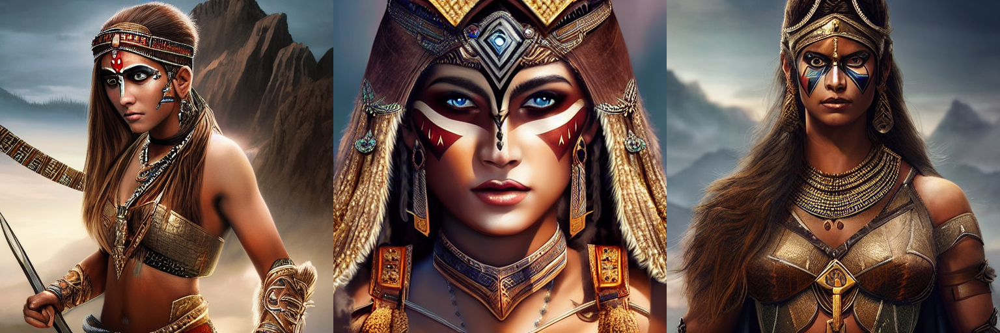

In [ ]:
# DPMSolverMultistepScheduler

pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

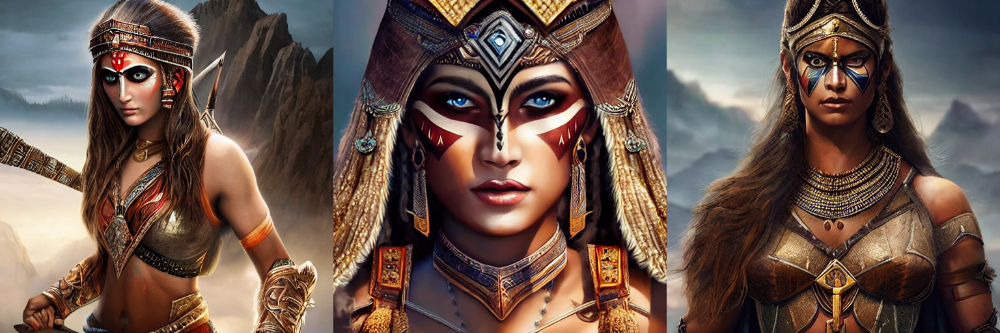

In [ ]:
# HeunDiscreteScheduler

pipeline.scheduler = HeunDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

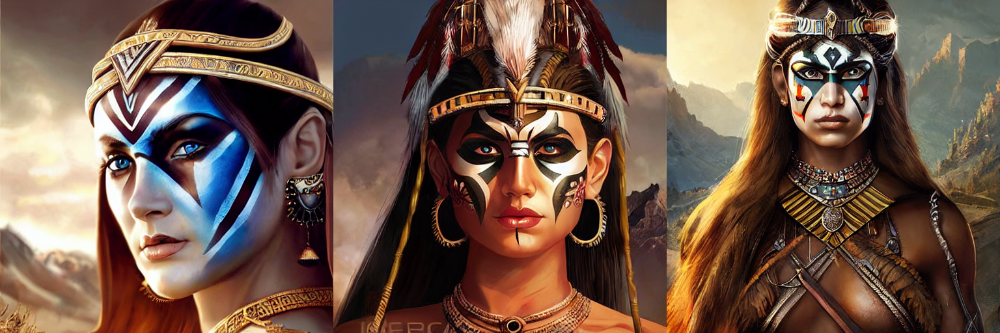

In [ ]:
# KDPM2AncestralDiscreteScheduler

pipeline.scheduler = KDPM2AncestralDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

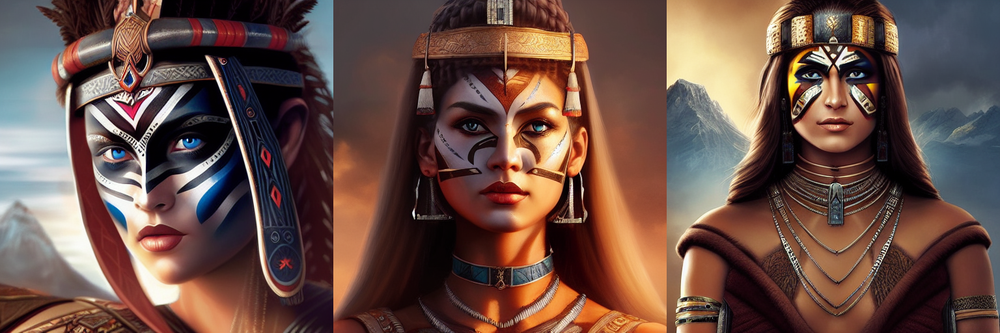

In [ ]:
# EulerAncestralDiscreteScheduler

pipeline.scheduler = EulerAncestralDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

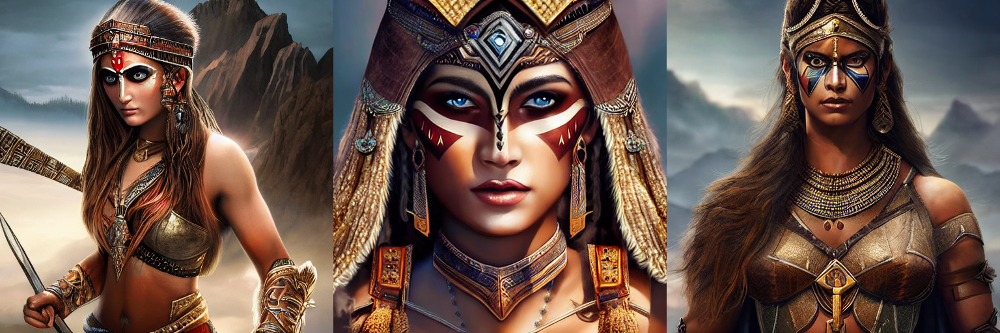

In [ ]:
# UniPCMultistepScheduler

pipeline.scheduler = UniPCMultistepScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

/usr/local/lib/python3.10/dist-packages/diffusers/configuration_utils.py:139: FutureWarning: Accessing config attribute `use_karras_sigmas` directly via 'DPMSolverSDEScheduler' object attribute is deprecated. Please access 'use_karras_sigmas' over 'DPMSolverSDEScheduler's config object instead, e.g. 'scheduler.config.use_karras_sigmas'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torchsde/_brownian/brownian_interval.py:599: UserWarning: Should have ta>=t0 but got ta=0.0291675366461277 and t0=0.029168.
  warnings.warn(f"Should have ta>=t0 but got ta={ta} and t0={self._start}.")


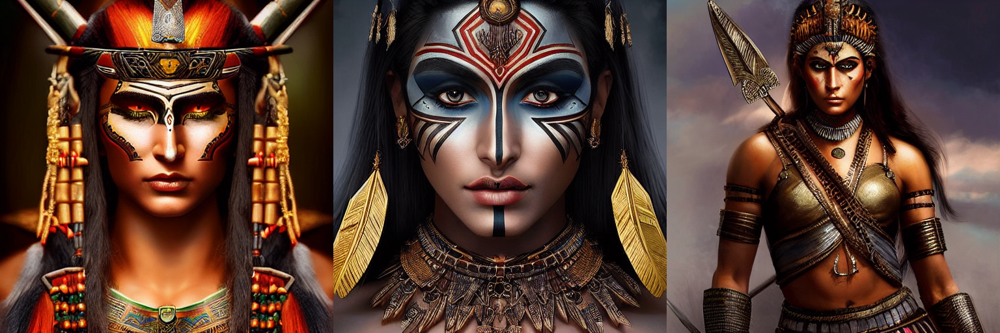

In [ ]:
# DPMSolverSDEScheduler

pipeline.scheduler = DPMSolverSDEScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

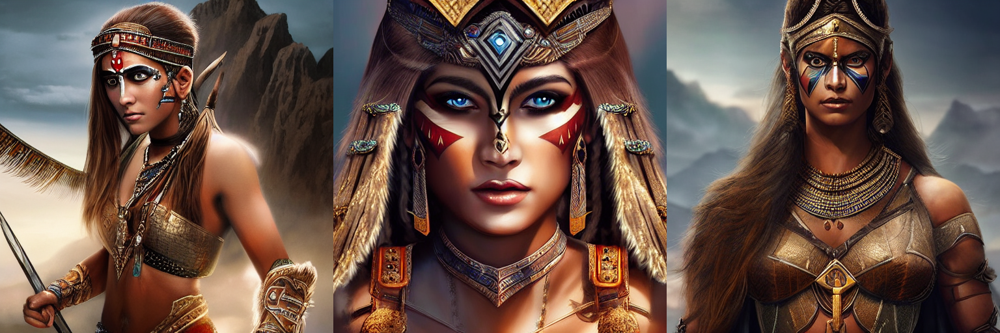

In [ ]:
# EulerDiscreteScheduler

pipeline.scheduler = EulerDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

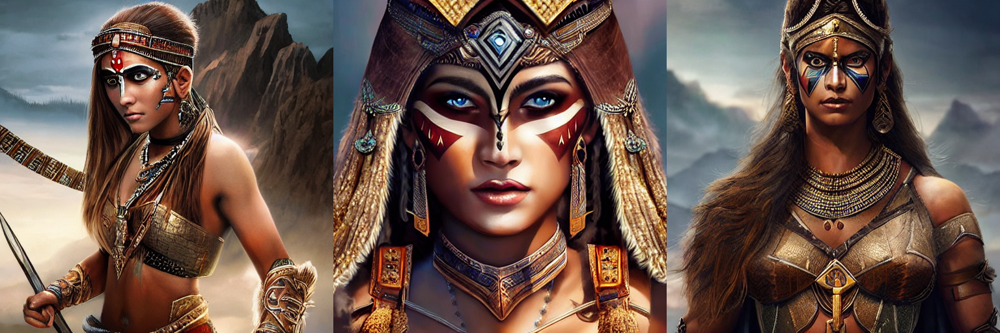

In [ ]:
# DEISMultistepScheduler

pipeline.scheduler = DEISMultistepScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

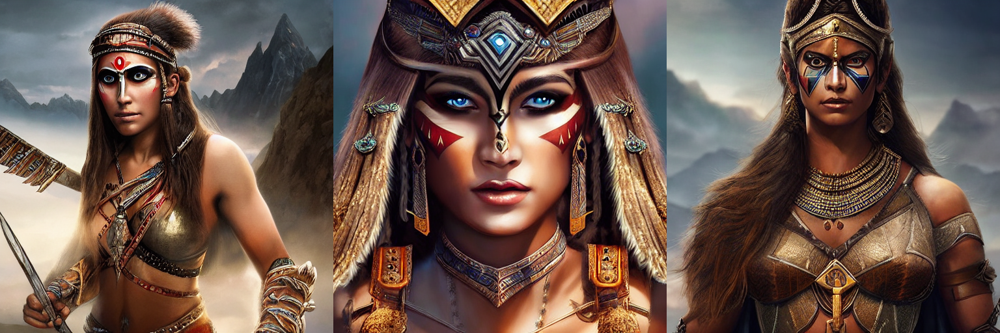

In [ ]:
# DDIMScheduler

pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

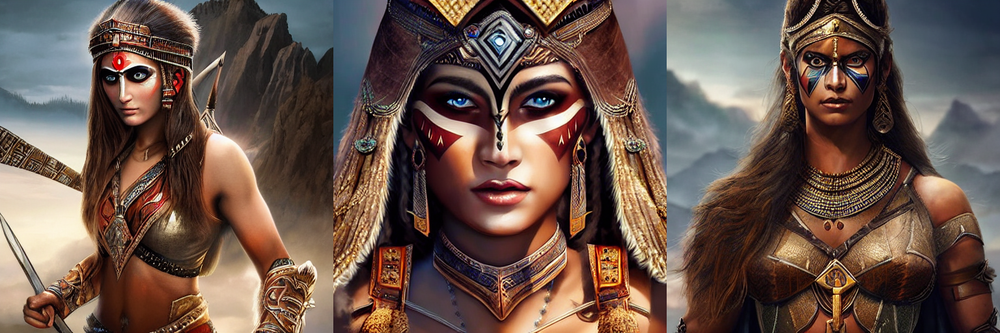

In [ ]:
# LMSDiscreteScheduler

pipeline.scheduler = LMSDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid